In [1]:
import cv2
import glob
from matplotlib.collections import PatchCollection
from matplotlib.patches import Polygon
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import subprocess
import sys
%matplotlib inline

In [2]:
w, h = 100, 200

# create a triangle
pts = np.array([
    [10, 20],
    [30, 170],
    [90, 125]
])

mb = []
for (i, j) in ((1, 0), (2, 0), (1, 2)):
    dx = pts[i, 0] - pts[j, 0]
    dy = pts[i, 1] - pts[j, 1]
    m = dy / dx
    b = pts[j, 1] - m * pts[j, 0]
    mb.append([m, b])

# create an image of a triangle
Z = np.zeros((h, w, 3)).astype('uint8')

# loop through x coords
for i in range(h):
    # loop through y coords
    for j in range(w):
        # start by assuming that point falls within triangle
        z = 255
        # loop through the 3 lines
        for k, (m, b) in enumerate(mb):
            if k == 1:
                if i < (m*j+b):
                    z = 0
            else:
                if i > (m*j+b):
                    z = 0
        
        Z[i, j, 0] = z

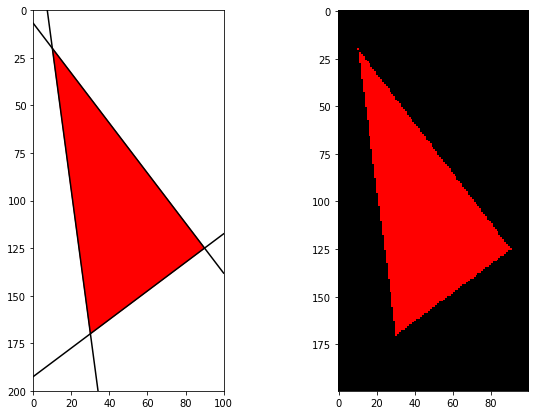

In [3]:
fig, ax = plt.subplots(1, 2, figsize=(10, 7))

for (m, b) in mb:
    ax[0].plot(np.r_[0, w], m*np.r_[0, w]+b, 'k')

ax[0].add_patch(Polygon(pts, color='r'))
ax[0].set_xlim((0, w))
ax[0].set_ylim((h, 0))
ax[0].set_aspect(1)
ax[1].imshow(Z)
ax[1].set_aspect(1)
plt.show()

In [4]:
# rotation and translation
phi = np.pi/36
phi = 0
M = np.array([
    [np.cos(phi), -np.sin(phi), -10],
    [np.sin(phi), np.cos(phi), 20],
    [0, 0, 1]
]).T

In [5]:
M

array([[  1.,   0.,   0.],
       [ -0.,   1.,   0.],
       [-10.,  20.,   1.]])

In [6]:
pts_ = (np.c_[pts, [1, 1, 1]] @ M).astype(int)[:, :2]
pts_

array([[  0,  40],
       [ 20, 190],
       [ 80, 145]])

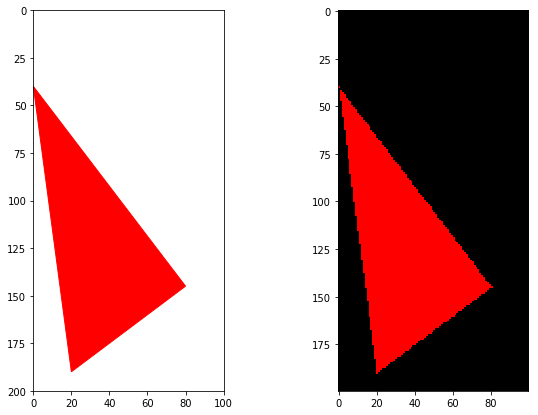

In [7]:
# apply translation
fig, ax = plt.subplots(1, 2, figsize=(10, 7))
ax[0].add_patch(Polygon(pts_, color='r'))
ax[0].set_xlim((0, w))
ax[0].set_ylim((h, 0))
ax[0].set_aspect(1)
ax[1].imshow(cv2.warpAffine(Z, M[:, :2].T.astype('float32'), (w, h)))
ax[1].set_aspect(1)
plt.show()

In [8]:
# repeat for actual images
anchors = pd.read_csv('points.csv', delimiter=';').set_index('fname')
npts = anchors.shape[1] // 2

f0, f1 = ['images/IMG_%04d.jpeg' % i for i in (919, 1015)]
z0, z1 = cv2.imread(f0), cv2.imread(f1)
h, w, _ = z0.shape

pt0 = anchors.loc[f0].values.reshape((npts, 2))
pt1 = anchors.loc[f1].values.reshape((npts, 2))


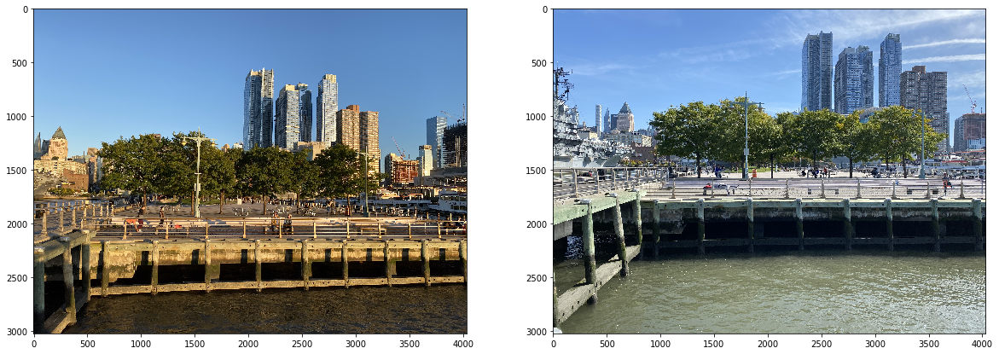

In [9]:
fig, ax = plt.subplots(1, 2, figsize=(20, 7))
ax[0].imshow(z0[:, :, ::-1])
ax[1].imshow(z1[:, :, ::-1])
plt.show()

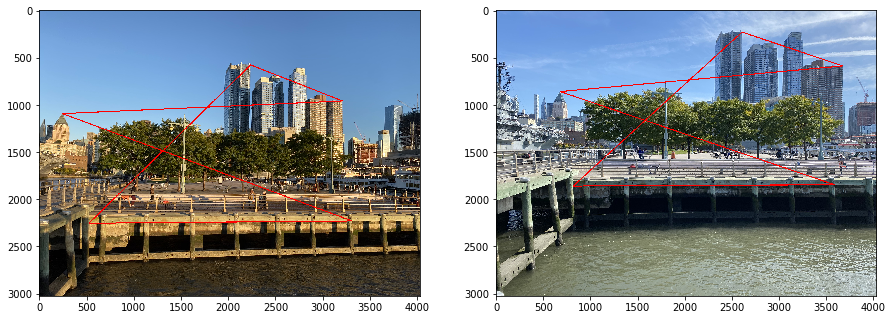

In [10]:
pts = np.array(np.c_[pt0[:, 0], h - pt0[:, 1]].tolist(), np.int32)
pts_0 = pts.reshape((-1, 1, 2))
zt0 = cv2.polylines(z0, [pts_0], True, (0, 0, 255), thickness=10)

pts = np.array(np.c_[pt1[:, 0], h - pt1[:, 1]].tolist(), np.int32)
pts_1 = pts.reshape((-1, 1, 2))
zt1 = cv2.polylines(z1, [pts_1], True, (0, 0, 255), thickness=10)

fig, ax = plt.subplots(1, 2, figsize=(15, 15))
ax[0].imshow(zt0[:, :, ::-1])
ax[1].imshow(zt1[:, :, ::-1])
plt.show()

In [11]:
# compute transformation
m0 = np.c_[pts_0[:, 0], np.ones(npts)]
m1 = np.c_[pts_1[:, 0], np.ones(npts)]
M = np.linalg.pinv(m0) @ m1

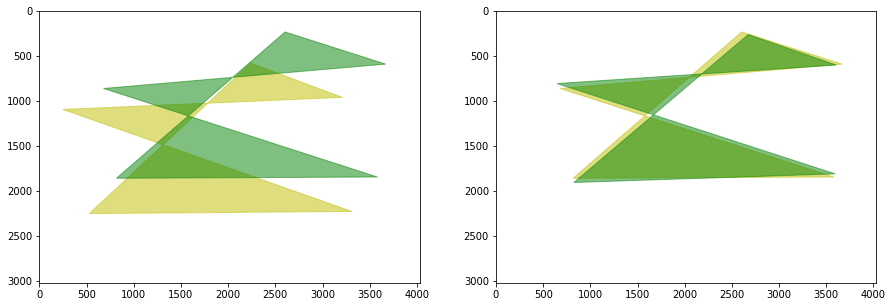

In [12]:
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
ax[0].add_patch(Polygon(pts_0[:, 0], alpha=0.5, color='y'))
ax[0].add_patch(Polygon(pts_1[:, 0], alpha=0.5, color='g'))
ax[0].set_xlim((0, w))
ax[0].set_ylim((h, 0))

ax[1].add_patch(Polygon(m1[:, :2], alpha=0.5, color='y'))
ax[1].add_patch(Polygon((m0 @ M).astype('int')[:, :2], alpha=0.5, color='g'))
ax[1].set_xlim((0, w))
ax[1].set_ylim((h, 0))
plt.show()

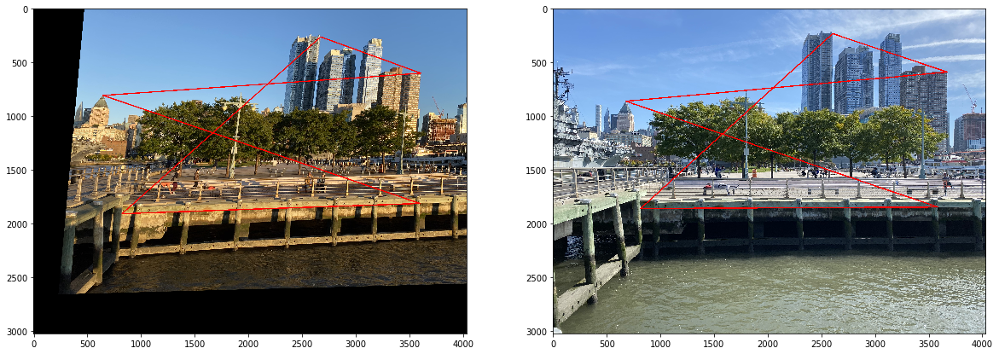

In [13]:
fig, ax = plt.subplots(1, 2, figsize=(20, 7))

#M[:, :2].T.astype('float32')
zW = cv2.warpAffine(zt0, M[:, :2].T.astype('float32'), (w, h))

ax[0].imshow(zW[:, :, ::-1])
ax[1].imshow(zt1[:, :, ::-1])
plt.show()

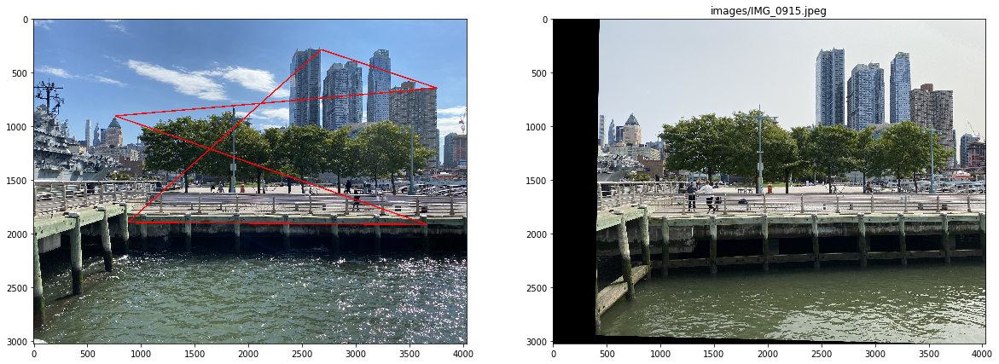

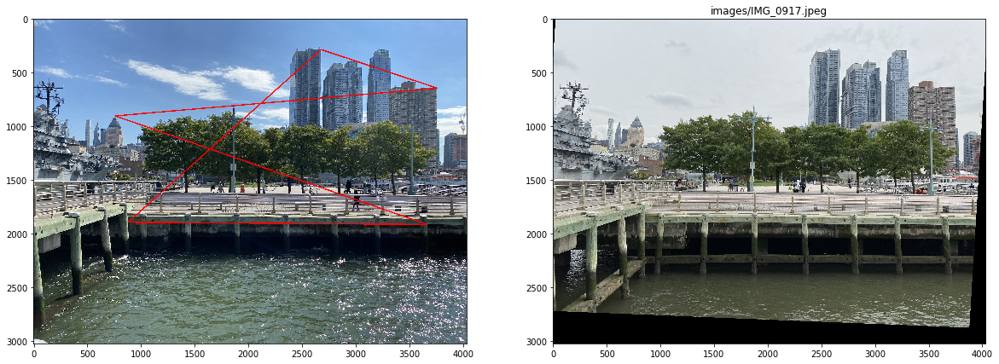

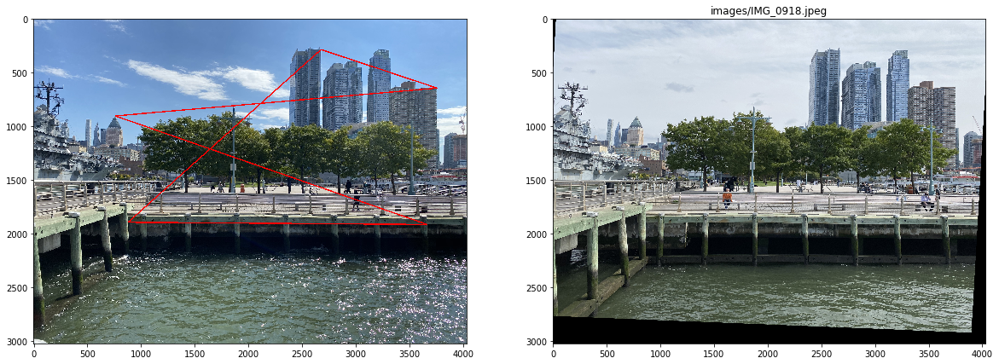

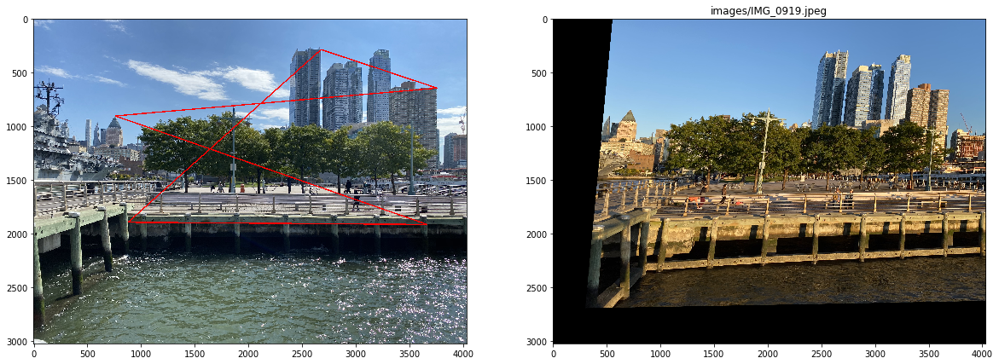

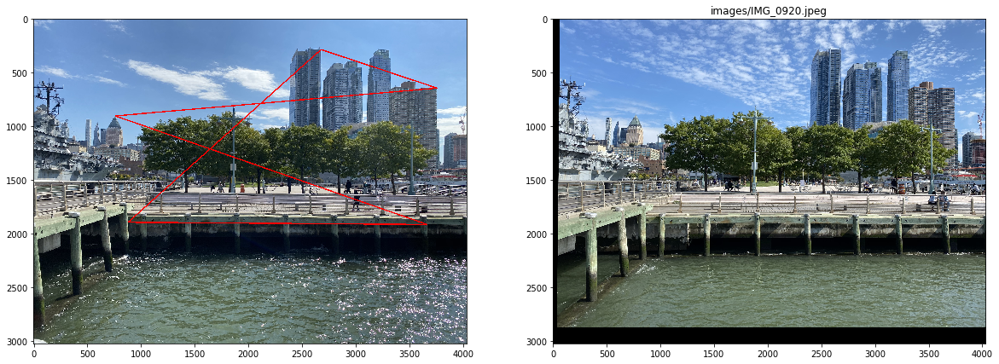

...

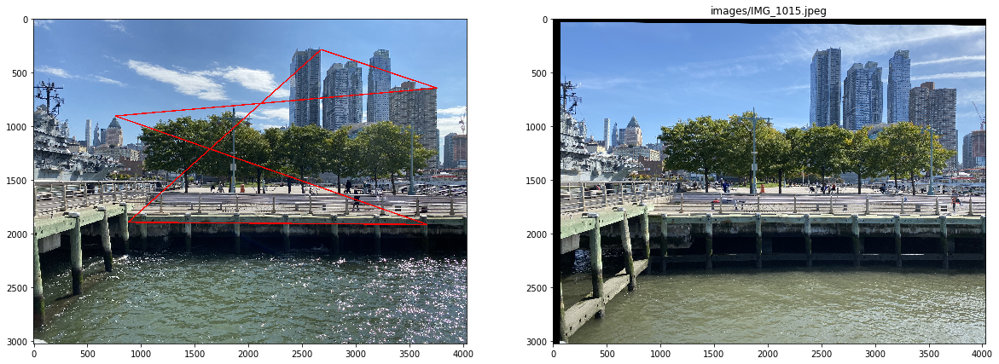

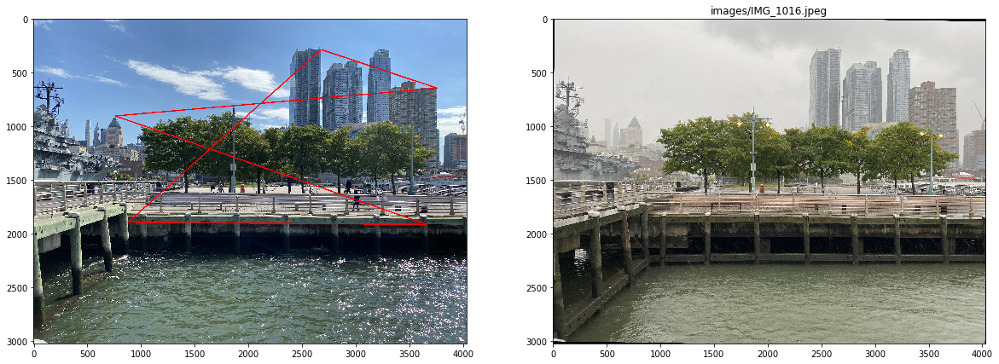

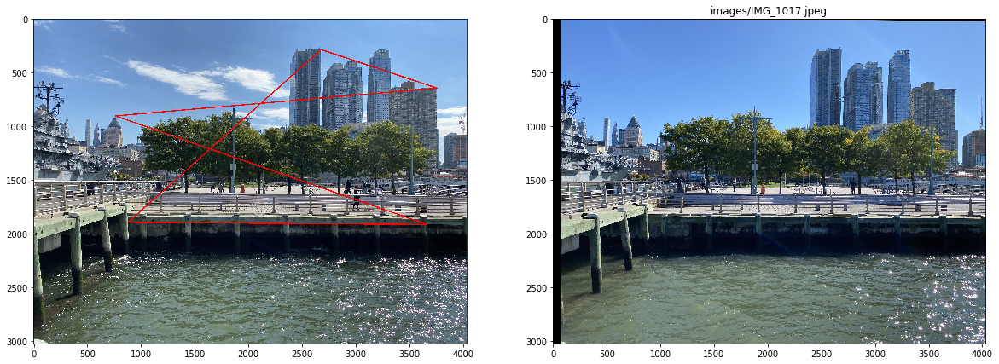

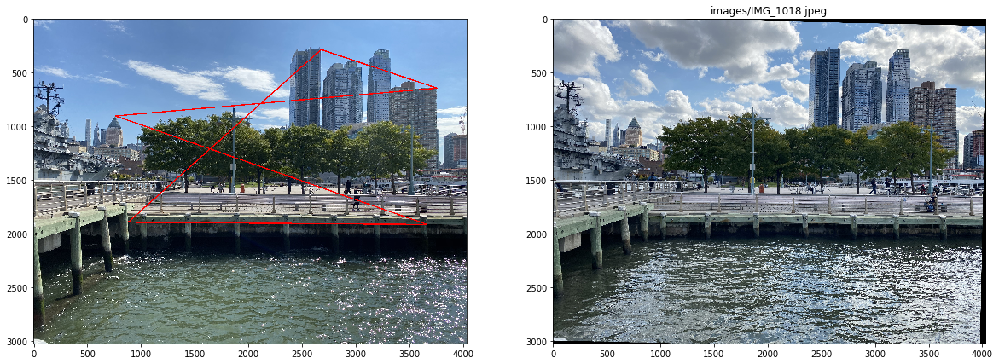

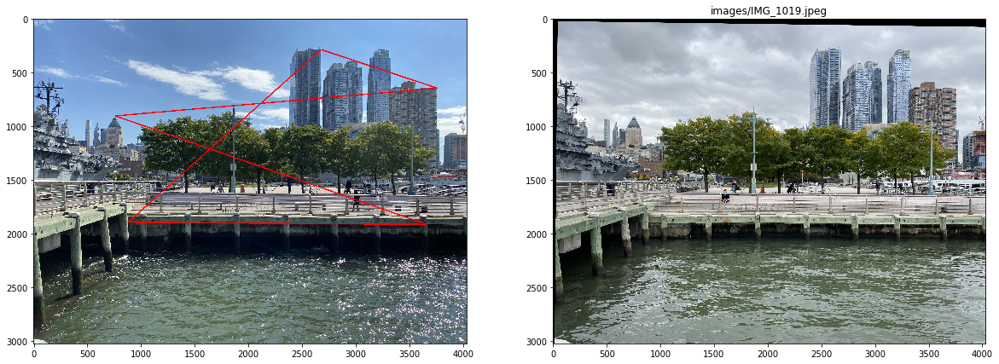

In [14]:
# repeat for all images
anchors = pd.read_csv('points.csv', delimiter=';').set_index('fname')

# index image
f0 = 'images/IMG_1001.jpeg'
z0 = cv2.imread(f0)
h, w, _ = z0.shape
pt0 = anchors.loc[f0].values.reshape((npts, 2))

pts = np.array(np.c_[pt0[:, 0], h - pt0[:, 1]].tolist(), np.int32)
pts_0 = pts.reshape((-1, 1, 2))
zt0 = cv2.polylines(z0, [pts_0], True, (0, 0, 255), thickness=10)
m0 = np.c_[pts_0[:, 0], np.ones(npts)]

z_all = []
zw_all = []

for f1 in sorted(glob.glob('images/*.jpeg')):

    z1 = cv2.imread(f1)
    z_all.append(z1)
    
    pt1 = anchors.loc[f1].values.reshape((npts, 2))

    pts = np.array(np.c_[pt1[:, 0], h - pt1[:, 1]].tolist(), np.int32)
    pts_1 = pts.reshape((-1, 1, 2))
    #zt1 = cv2.polylines(z1, [pts_1], True, (0, 0, 255), thickness=10)

    # compute transformation
    
    m1 = np.c_[pts_1[:, 0], np.ones(npts)]
    M = np.linalg.pinv(m1) @ m0
    
    fig, ax = plt.subplots(1, 2, figsize=(20, 7))

    zW = cv2.warpAffine(z1, M[:, :2].T.astype('float32'), (w, h))
    zw_all.append(zW)
    
    ax[0].imshow(zt0[:, :, ::-1])
    ax[1].set_title(f1)
    ax[1].imshow(zW[:, :, ::-1])
    plt.show()

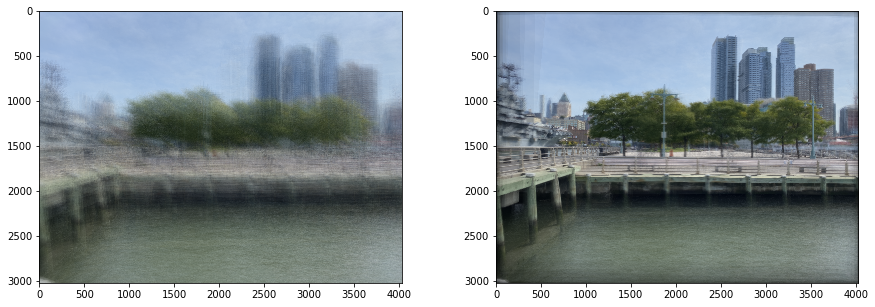

In [15]:
Z = np.array(z_all).astype(float).mean(0).astype('uint8')[:, :, ::-1]
Zw = np.array(zw_all).astype(float).mean(0).astype('uint8')[:, :, ::-1]

fig, ax = plt.subplots(1, 2, figsize=(15, 5))
ax[0].imshow(Z)
ax[1].imshow(Zw)
plt.show()

In [21]:
subprocess.call('rm autumn.gif', shell=True)

scale = 4
i = 1

for z in zw_all[:3] + zw_all[4:]:
    z = z[100:-500, 500:-200]
    h, w, _ = z.shape
    z = cv2.resize(z, (w // scale, h // scale))
    
    z = cv2.putText(z, '%d' % i, (50, 50), cv2.FONT_HERSHEY_SIMPLEX,  
                   1, (255, 255, 255), 2, cv2.LINE_AA)
    
    outfile = 'tmp_%03d.jpeg' % i
    cv2.imwrite(outfile, z)
    
    
    i += 1

cmd = 'convert -delay 1x10 `seq -f tmp_%%03g.jpeg 1 1 %d` -coalesce -duplicate 1,-2-1 -loop 0 autumn.gif' % (i-1)
subprocess.call(cmd, shell=True)
subprocess.call('rm tmp*.jpeg', shell=True)

0